In [1]:
import pandas as pd
import plotly.express as px
from plotly.offline import init_notebook_mode, iplot

In [2]:
df = pd.read_csv("VoltageTimeSeries_Updated.csv")
df_peripheral = pd.read_csv("../129Channels_v2.csv")
df_peripheral.rename(columns={"Unnamed: 0": "Electrode"}, inplace=True)
df_peripheral.fillna(0, inplace=True)
df_peripheral.drop(columns=["X", "Y", "Z"], inplace=True)
# dropping last 1 row
df.drop(df.tail(1).index, inplace=True)

In [3]:
# melting dataframe so each row contains information about time and voltage for each electrode,
# instead of having time as a column
df = pd.melt(df, id_vars=df.columns[:4].tolist(), value_vars=df.columns[4:].tolist(),
             var_name='Time', value_name='Voltage (uV)')

In [4]:
# taking the ' ' out of electrode column
df.Electrode = df.Electrode.str.split("\'").str[1]
# box plot to find voltage outliers (excluding peripheral channel) for setting heatmap color scale range
df = df.merge(df_peripheral, on="Electrode", how="left")
df_no_peripheral = df[df["Peripheral Channel"] == 1.0]

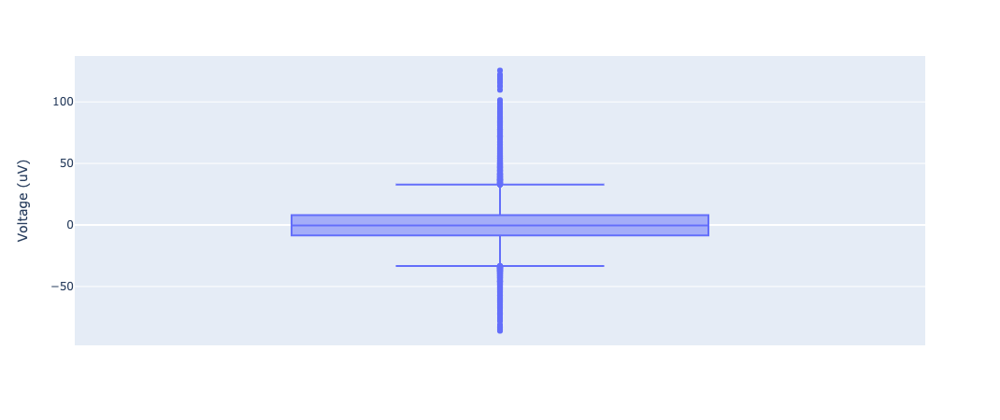

Total Number of Voltages: 55000
Number of Voltages above 33: 1130 , 2.0545454545454542% of total voltages
Number of Voltages below -33: 880 , 1.6% of total voltages


In [5]:
fig = px.box(df_no_peripheral, y="Voltage (uV)")
iplot(fig)
upper_bound = 33
lower_bound = -33
print("Total Number of Voltages:", len(df_no_peripheral))
print("Number of Voltages above " + str(upper_bound) + ":", df_no_peripheral["Voltage (uV)"][df_no_peripheral["Voltage (uV)"] > upper_bound].count(),
      ", " + str(df_no_peripheral["Voltage (uV)"][df_no_peripheral["Voltage (uV)"] > upper_bound].count()/len(df_no_peripheral)*100)+"% of total voltages")
print("Number of Voltages below " + str(lower_bound) + ":", df_no_peripheral["Voltage (uV)"][df_no_peripheral["Voltage (uV)"] < lower_bound].count(),
      ", " + str(df_no_peripheral["Voltage (uV)"][df_no_peripheral["Voltage (uV)"] < lower_bound].count()/len(df_no_peripheral)*100)+"% of total voltages")

In [6]:
 # calculating which epoch each time corresponds to
df["Epoch"] = df.Time.str.split(".").str[1]
df.Time = df.Time.str.split(".").str[0]
df.Epoch.fillna(0, inplace=True)
df.Epoch = pd.to_numeric(df.Epoch)
df.Epoch = df.Epoch + 1
# creating Frame column to display on the slider
df["Frame"] = "Epoch: " + df.Epoch.astype(str) + ", Time(ms): " + df.Time

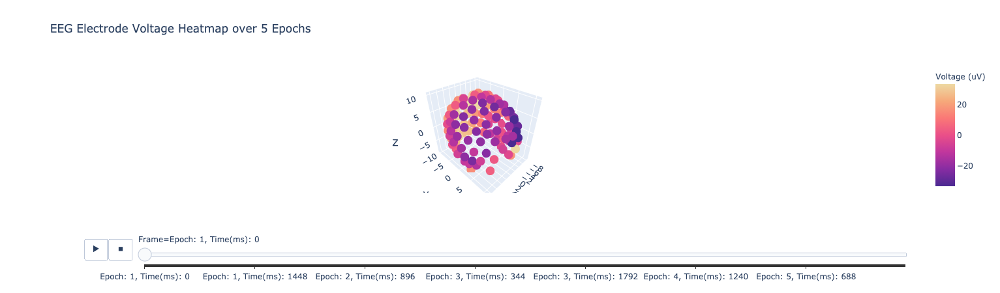

In [7]:
# creating plot
fig = px.scatter_3d(df, x="X", y="Y", z="Z", color="Voltage (uV)",
                    animation_frame="Frame", animation_group="Voltage (uV)", range_color=[-33, 33],
                    color_continuous_scale=px.colors.sequential.Agsunset,
                    title="EEG Electrode Voltage Heatmap over 5 Epochs")

# modifying animation speed
fig.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = .000000001
fig.layout.updatemenus[0].buttons[0].args[1]['transition']['duration'] = .000000001
iplot(fig)